# AdaBoost

## Load ds

In [41]:
import pandas as pd

path_chips = "/home/vutaliy/Downloads/chips.csv"
path_geyser = "/home/vutaliy/Downloads/geyser.csv"

ds_chips = pd.read_csv(path_chips)
ds_geyser = pd.read_csv(path_geyser)
ds_geyser

,x,y,class
0,1,4.4,N
1,1,3.9,N
2,1,4.0,P
3,1,4.0,N
4,1,3.5,N
...,...,...,...
217,23,2.1,P
218,23,4.2,N
219,23,2.1,P
220,23,5.2,N


## Boosting

In [65]:
from sklearn.tree import DecisionTreeClassifier
from math import log, exp
import random as rnd
import numpy as np


class AdaBoost():
    def __init__(self, size, criterion = "gini", splitter = "best", max_depth = 1):
        self.size = size
        self.criterion = criterion
        self.splitter = splitter
        self.forest = []
        self.weights = []
        self.X = []
        self.Y = []
        self.aoses = []
        self.max_depth = max_depth

    def _fit_one(self):
        tree = DecisionTreeClassifier(criterion=self.criterion, splitter=self.splitter, max_depth=self.max_depth)
        tree.fit(self.X, self.Y, self.weights)
        pred = tree.predict(self.X)

        upd_w = self._find_wrong(pred)
        aos = self._aos([u * w for u, w in zip(upd_w, self.weights)])
        return tree, aos, upd_w

    def fit(self, x, y):
        self.X = x
        self.Y = y
        self.weights = [1 / x.shape[0] for i in range(x.shape[0])]

        for i in range(0, self.size):
            tree, aos, upd = self._fit_one()       
            self.forest.append(tree)
            self.aoses.append(aos)

            self._reweight(aos, upd)
    
    def _predict_one(self, one_x):
        counts = [0] * 2

        for aos, tree in zip(self.aoses, self.forest):
            counts[tree.predict([one_x])[0]] += aos
            # print(tree.predict([one_x])[0])
        # print(counts)
        
        return counts.index(max(counts))

    def predict(self, xs):
        preds = [self._predict_one(x) for x in xs]
        # print(preds)
        return preds

    def _find_wrong(self, pred):
        return [ 1 if p != y else 0 for p, y in zip(pred, self.Y) ]

    @staticmethod
    def _total_error(weights):
        return sum(weights)

    def _aos(self, weights):
        err = self._total_error(weights)
        return log((1 - err) / err) / 2
    
    def _reweight(self, aos, upd):
        buff = [ w * exp(aos) if u == 1 else w * exp(-aos) for w, u in zip(self.weights, upd) ]
        self.weights = [ x / sum(buff) for x in buff]
        # print(self.weights)
    
    @staticmethod
    def _accuracy(answers, classes):
        return sum([x == y for x, y in zip(answers, classes)]) / len(answers)
                

b = AdaBoost(1, max_depth = 3)
np_ds_geyser = ds_geyser.to_numpy()
ys = ds_geyser['class'].to_numpy()
ys = [ 0 if x == 'N' else 1 for x in ys]
xs = np_ds_geyser[:,0:2]

b.fit(xs, ys)

# print(pred)
pred = b.predict(xs)
b._accuracy(pred, ys)


0.9099099099099099

## Accuracy plots

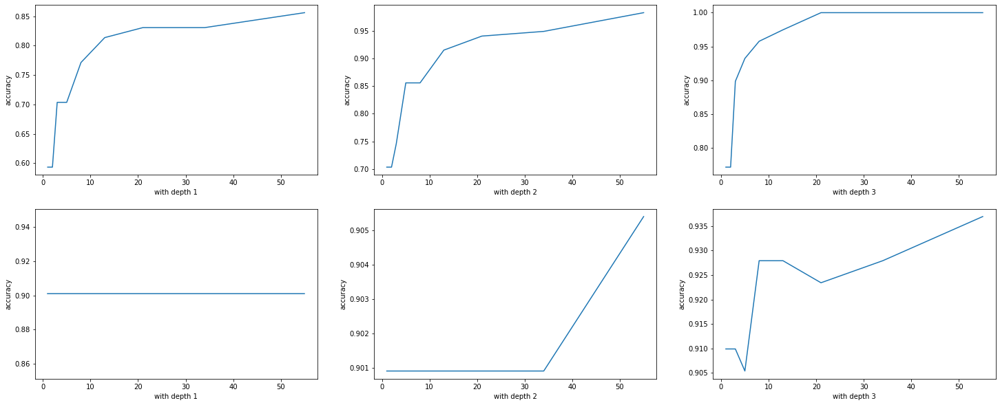

In [66]:
import matplotlib.pyplot as plt

np_ds_chips = ds_chips.to_numpy()
cys = ds_chips['class'].to_numpy()
cys = [ 0 if x == 'N' else 1 for x in cys ]
cxs = np_ds_chips[:,0:2]

np_ds_geyser = ds_geyser.to_numpy()
gys = ds_geyser['class'].to_numpy()
gys = [ 0 if x == 'N' else 1 for x in gys ]
gxs = np_ds_geyser[:,0:2]


sizes = [1, 2, 3, 5, 8, 13, 21, 34, 55]
fig, axs = plt.subplots(2, 3)

fig.set_figheight(10)
fig.set_figwidth(25)
# axs[0][0].plot(sizes,sizes)

def generate_plots(xs, ys, j):
    for i in range(0,3):
        accuracies = []

        for size in sizes:
            boost = AdaBoost(size, max_depth=i+1)
            boost.fit(xs, ys)
            pred = boost.predict(xs)
            accuracies.append(boost._accuracy(pred, ys))

        axs[j][i].plot(sizes, accuracies)
        axs[j][i].set_xlabel('with depth {0}'.format(i+1))
        axs[j][i].set_ylabel('accuracy')

generate_plots(cxs, cys, 0)
generate_plots(gxs, gys, 1)

plt.show()



## Plots for dimension classification 

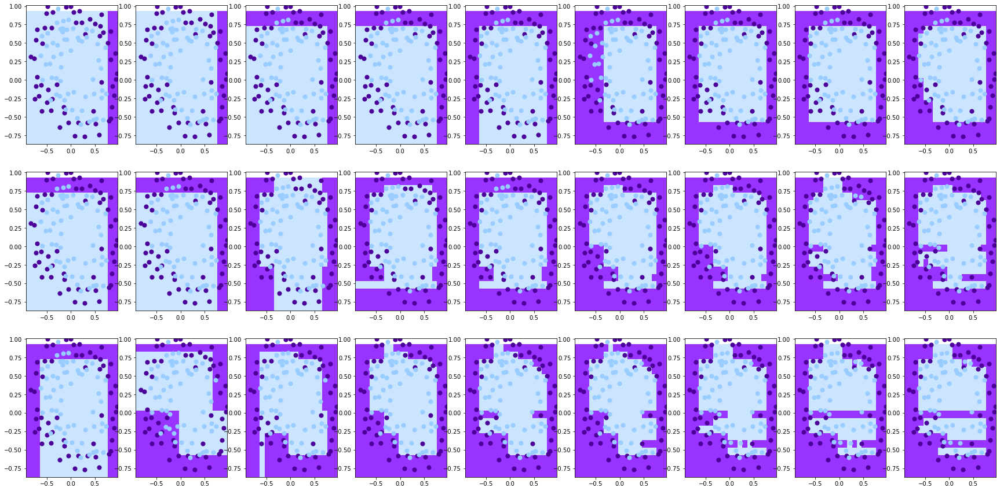

In [117]:
from matplotlib.colors import ListedColormap

fig, axs = plt.subplots(3, len(sizes))

fig.set_figheight(15)
fig.set_figwidth(30)

def generate_one(b, X, y, ax):
    step = 0.1
    x_min, y_min = np.amin(X, 0)
    x_max, y_max = np.amax(X, 0)
    x_min, x_max, y_min, y_max = x_min - step, x_max - step, y_min - step, y_max - step

    xx, yy = np.meshgrid(np.arange(x_min, x_max, step), np.arange(y_min, y_max, step))
    mesh_dots = np.c_[xx.ravel(), yy.ravel()]
    zz = b.predict(mesh_dots)
    zz = np.array(zz).reshape(xx.shape)
    
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)

    xs1 = []
    ys1 = []
    xs2 = []
    ys2 = []
    
    for x, cs in zip(X, y):
        if cs == 0:
            xs1.append(x[0])
            ys1.append(x[1])
        else:
            xs2.append(x[0])
            ys2.append(x[1])
    
    ax.pcolormesh(xx, yy, zz, cmap=ListedColormap(['#9933FF', '#CCE5FF']))
    ax.scatter(xs1, ys1, color='#4C0099', s=50)
    ax.scatter(xs2, ys2, color='#99CCFF', s=50)


def generate_dim_plots(xs, ys):
    for i in range(0,3):
        accuracies = []

        for size in sizes:
            boost = AdaBoost(size, max_depth=i+1)
            boost.fit(xs, ys)
            generate_one(boost, xs, ys, axs[i][sizes.index(size)])

generate_dim_plots(cxs, cys)
plt.show()


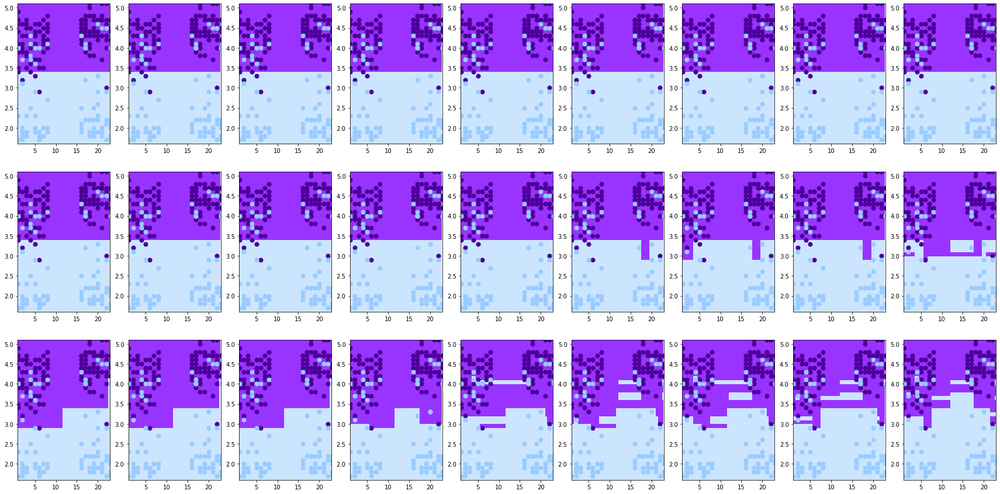

In [118]:
fig, axs = plt.subplots(3, len(sizes))

fig.set_figheight(15)
fig.set_figwidth(30)

generate_dim_plots(gxs, gys)
plt.show()
